# Cloudstor access to a public share via WebDAV

In [this notebook](cloudstor-share-nested-links.ipynb) I demonstrated how you could create and share links to nested resources in Cloudstor. This makes it easy to access and download files. 

An alternative to manually constructing links is to use a WebDAV client. It takes a bit of effort to configure, but once it's set up you can access information about, and download, publicly shared files and folders.

In [3]:
import random
from io import BytesIO
from pathlib import Path

import requests
from IPython.display import Image
from webdav3.client import Client

## Configuration

I'm using the [Python WebDAVClient3](https://pypi.org/project/webdavclient3/) package. To initialise the client you need four pieces of information:

* `webdav_hostname`
* `webdav_login`
* `webdav_password`
* `webdav_root`

It took a bit of experimenting, but I finally worked out what values these should have. The [critical thing](https://support.aarnet.edu.au/hc/en-us/articles/360000741156-Accessing-public-links-over-WebDAV) is that you set the `webdav_login` to the value of the token in the share link. For example, I've uploaded thousands of cartoons harvested from *The Bulletin* via Trove to my CloudStor account and created a public link:

<https://cloudstor.aarnet.edu.au/plus/s/bI7hJREvO0oJLGL>.

The bit on the end is the token that you use as the `webdav_login`: 'bI7hJREvO0oJLGL'.

No value for `webdav_password` is required by the server, however, it seems that the webdav3 client won't configure the authentication correctly unless there's something in the password field. So set `webdav_password` to anything just to keep the client happy.

The `webdav_hostname` is just the CloudStor url, but what is the `webdav_root`? This had me flummoxed for a while, but eventually I realised that for public shares you have to change the `remote.php` in the standard WebDAV link to `public.php`.

BINGO!

So here are the config details we'd use to access the *Bulletin* cartoons.

In [69]:
options = {
    "webdav_hostname": "https://cloudstor.aarnet.edu.au/",
    "webdav_login": "bI7hJREvO0oJLGL",
    "webdav_password": "anything",
    "webdav_root": "/plus/public.php/webdav/",
}

To initialise the client we just supply it with the config options.

In [83]:
client = Client(options)

## List files in this folder

In [84]:
files = client.list()

How many Bulletin cartoons are there?

In [85]:
len(files)

3471

List the first 10 images.

In [86]:
files[:10]

['18860904-344-nla.obj-507862411-1.jpg',
 '18860911-345-nla.obj-507862433-1.jpg',
 '18860918-346-nla.obj-507886099-1.jpg',
 '18860925-347-nla.obj-507886214-1.jpg',
 '18861002-348-nla.obj-507886238-1.jpg',
 '18861009-349-nla.obj-507886393-1.jpg',
 '18861016-350-nla.obj-507886433-1.jpg',
 '18861023-351-nla.obj-507886454-1.jpg',
 '18861030-352-nla.obj-507886574-1.jpg',
 '18861106-353-nla.obj-507886719-1.jpg']

## Get information about a file

In [94]:
first_img = client.resource(files[0])

In [95]:
first_img.info()

{'created': None,
 'name': None,
 'size': '16785875',
 'modified': 'Mon, 11 Jun 2018 12:31:47 GMT',
 'etag': '"74deffdea78d53c44f3b434c3d7ba3e6"',
 'content_type': 'image/jpeg'}

## Display an image

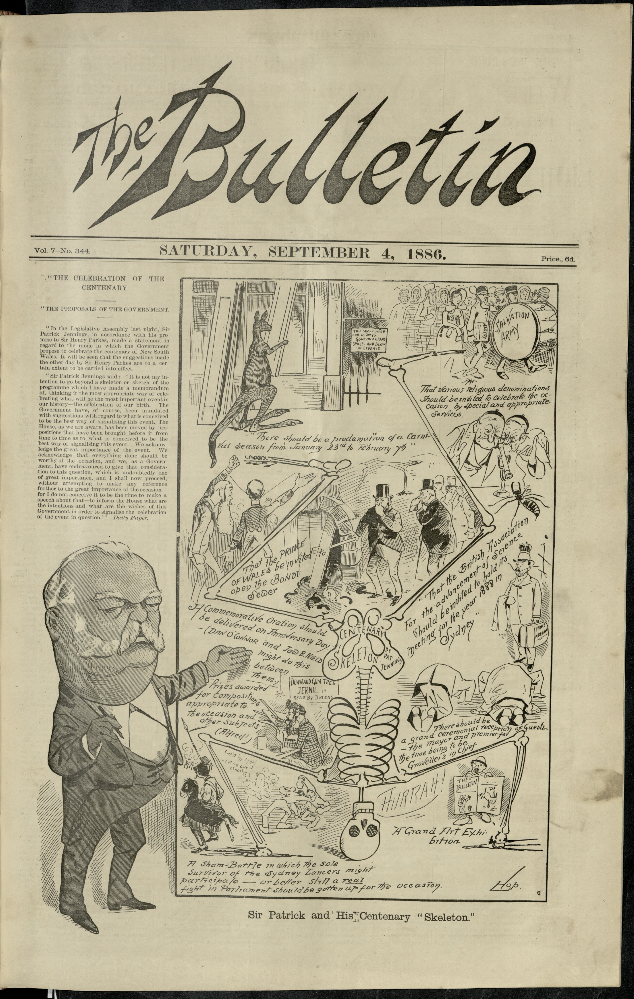

In [96]:
buffer = BytesIO()
first_img.write_to(buffer)
Image(buffer.getvalue(), width=300)

## Display a random image

You can also use information from WebDAV to construct direct urls as described in this notebook. So instead of using the `webdav3` client to write images to a BytesIO buffer as above, you can use `requests` directly. 

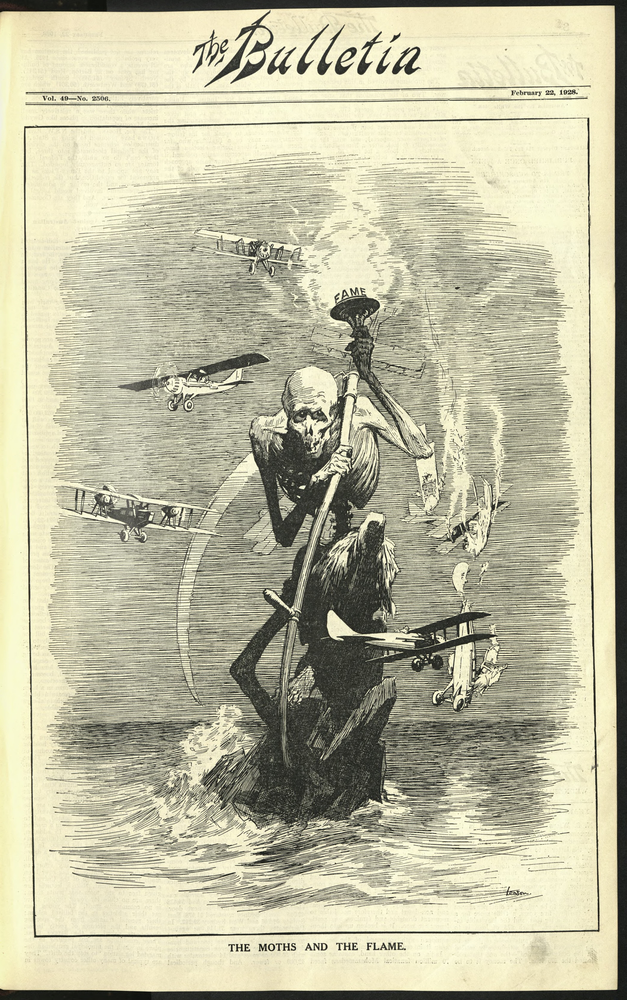

In [97]:
# Select a random image
img_name = random.choice(files)

# Download image using requests
response = requests.get(
    "https://cloudstor.aarnet.edu.au/plus/s/bI7hJREvO0oJLGL/download",
    params={"path": img_name},
)

# Display the image
Image(response.content, width=300)

## Download all images from a specific year

The filenames of the Bulletin images start with the date they were published in the form `YYYYMMDD`. So it's easy to extract a list of images from a particular year (month, or day).

In [100]:
year = "1918"

# Filter the list of images to include only those from the specified year
images = [f for f in files if f.startswith(year)]

How many images are there from this year?

In [101]:
len(images)

52

Download all the images from this year. The images will be saved into a folder with the name of the specified year.

In [102]:
# Create a folder name for the year to contain the downloaded images
img_path = Path(year)
img_path.mkdir(exist_ok=True)

# Loop through the image filenames and download them
for img in images:
    # Use .write() to write a file to the filesystem
    client.resource(img).write(Path(img_path, img))

In [105]:
len(list(Path(year).glob("*.jpg")))

52